<a href="https://colab.research.google.com/github/fookseng/Pytorch-YOLOv5-object-detection/blob/main/pytorch_YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Part 1:**
## Clone repository and install dependencies.

In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -r yolov5/requirements.txt  # install dependencies

Cloning into 'yolov5'...
remote: Enumerating objects: 6990, done.
remote: Counting objects: 100% (96/96), done.
remote: Compressing objects: 100% (93/93), done.
remote: Total 6990 (delta 48), reused 16 (delta 3), pack-reused 6894
Receiving objects: 100% (6990/6990), 9.10 MiB | 4.38 MiB/s, done.
Resolving deltas: 100% (4787/4787), done.
     |████████████████████████████████| 645kB 6.1MB/s 
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [2]:
#installing for google colab GPU use
#!pip install torch==1.6.0+cu101 torchvision==0.7.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html


In [3]:
%cd /content/yolov5

/content/yolov5


In [4]:
import torch
from IPython.display import Image  # for displaying images
from utils.google_utils import gdrive_download  # for downloading models/datasets

print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


# **Part 2:**
## Get your images and annotations ready!
*An example for the images and annotations are provided in Github.* 
In this tutorial, I will upload my dataset from my local computer.

---



Directory organization: https://github.com/ultralytics/yolov5/wiki/Train-Custom-Data
*It is best to name your folder 'images' and 'labels'.*


---



Example: <br>
train- <br>
| images <br>
| labels <br>
<br>
valid-<br>
| images <br>
| labels


---



In [5]:
# Download dataset from internet.
#!curl -L "https://app.roboflow.com/{key}" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
# Unzip uploaded folders
!unzip /content/train.zip
!unzip /content/valid.zip 

Archive:  /content/train.zip
   creating: train/
   creating: train/images/
  inflating: train/images/10_1.jpg   
  inflating: train/images/10_17.jpg  
  inflating: train/images/10_18.jpg  
  inflating: train/images/10_19.jpg  
  inflating: train/images/10_20.jpg  
  inflating: train/images/10_21.jpg  
  inflating: train/images/10_3.jpg   
  inflating: train/images/10_4.jpg   
  inflating: train/images/10_5.jpg   
  inflating: train/images/12_13.jpg  
  inflating: train/images/12_4.jpg   
  inflating: train/images/12_5.jpg   
  inflating: train/images/13_1.jpg   
  inflating: train/images/13_3.jpg   
  inflating: train/images/13_4.jpg   
  inflating: train/images/13_5.jpg   
  inflating: train/images/13_6.jpg   
  inflating: train/images/13_7.jpg   
  inflating: train/images/13_8.jpg   
  inflating: train/images/13_9.jpg   
  inflating: train/images/14_13.jpg  
  inflating: train/images/14_14.jpg  
  inflating: train/images/14_15.jpg  
  inflating: train/images/14_17.jpg  
  inflating:

You need to write a 'data.yaml' file for training usage. [Reference](https://github.com/ultralytics/yolov5/wiki/Train-Custom-Data)
---



In [6]:
# I have written the file 'data.yaml', so will upload it from my local computer. 
# Print out the content of 'data.yaml'.
%cat /content/data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['stone']

After uploading the 'data.yaml' file, we need to make a little adjustment. Since the dataset path might be different.

---



In [7]:
# define number of classes based on YAML
# data.yaml contains the information about number of classes and their labels required for this project
import yaml
with open("/content/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [8]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

*Change the path of the dataset in 'data.yaml'. Since it might be different in your local computer and in here.*

---



In [9]:
# Below we are changing the data configuration for right path to the dataset
%%writetemplate /content/yolov5/data.yaml

train: /content/yolov5/train
val: /content/yolov5/valid

nc: 1
names: ['stone']

In [10]:
# Print the content of modified 'data.yaml' to make sure it is correct.
%cat data.yaml


train: /content/yolov5/train
val: /content/yolov5/valid

nc: 1
names: ['stone']

In [11]:
with open(r'data.yaml') as file:
    # The FullLoader parameter handles the conversion from YAML
    # scalar values to Python the dictionary format
    labels_list = yaml.load(file, Loader=yaml.FullLoader)

    label_names = labels_list['names']
print("Number of Classes are {}, whose labels are {} for this Object Detection project".format(num_classes,label_names))

Number of Classes are 1, whose labels are ['stone'] for this Object Detection project


# **Part 3:**
## Model configurations.
*You may try other model to obtain a better result.*

In [12]:
#this is the model configuration we will use for our tutorial
# yolov5l.yaml contains the configuration of neural network required for training.
%cat /content/yolov5/models/yolov5x.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

*Copy the content above and paste it below. We will only modify first line->* nc: {num_classes}.

---



In [13]:
# Below we are changing the configuration so that it becomes compatible to number of classes required in this project
%%writetemplate /content/yolov5/models/custom_yolov5x.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [14]:
# Check that we have successfully configure the model.
%cat /content/yolov5/models/custom_yolov5x.yaml


# parameters
nc: 1  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

*From the above content, you can see that in the first line, number of classes(nc) has changed to 1.*

---



# **Part 4:**
## Start our training.

In [15]:
import os
# Change our directory to /yolov5, since train.py file is under here.
os.chdir('/content/yolov5')

### **Some arguements you may use.**
*   img 640 - resize the images to 640x640 pixels
*   batch 4 - 4 images per batch
*   epochs 30 - train for 30 epochs
*   data ./data.yaml - path to dataset config (the 'data.yaml' file we uploaded and modified above.)
*   cfg ./models/yolov5x.yaml - model config (the custom model we created above.)
*   weights yolov5x.pt - use pre-trained weights from the YOLOv5x model
*   name yolov5x_stone - name of our model
*   cache - cache dataset images for faster training <br>
[Reference](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results)

In [16]:
# Weights & Biases  (optional)
# %pip install -q wandb
# import wandb
# wandb.login()

In [17]:
# train yolov5l on custom dataset object detection data for 600 epochs [aroung 1000 epochs for better training and result]
# NOTE: Kindly be aware of your image size.
# data.yaml also contains the information about location of Train and Validation Data. That's how you get the train data.
# the training also requires the configuration of neural network, which is in custom_yolov5l.yaml
# weights will be by-default stored at /content/yolov5/runs/exp2/weights/best.pt
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 640 --batch 4 --epochs 600 --data '/content/yolov5/data.yaml' --weights '' --cfg ./models/custom_yolov5x.yaml --name "yolov5_stone" --nosave

/content/yolov5
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-160-gb6fdd2e torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=4, bbox_interval=-1, bucket='', cache_images=False, cfg='./models/custom_yolov5x.yaml', data='/content/yolov5/data.yaml', device='', entity=None, epochs=600, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[640, 640], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5_stone', noautoanchor=False, nosave=True, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5_stone', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=4, upload_dataset=False, weights='', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-06-09 06:06:52.488935: I tensorflow/stream_executor/

If you encounter the error "RuntimeError: CUDA out of memory." <br>
Reduce the number of batch size. For example, reduce '--batch 32' to '--batch 8'.

---



# **Part 5:**
## We have done training, start Tensorboard!

In [18]:
# Start tensorboard
# Launch after you have started training to all the graphs needed for inspection
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs

<IPython.core.display.Javascript object>

GROUND TRUTH TRAINING DATA:


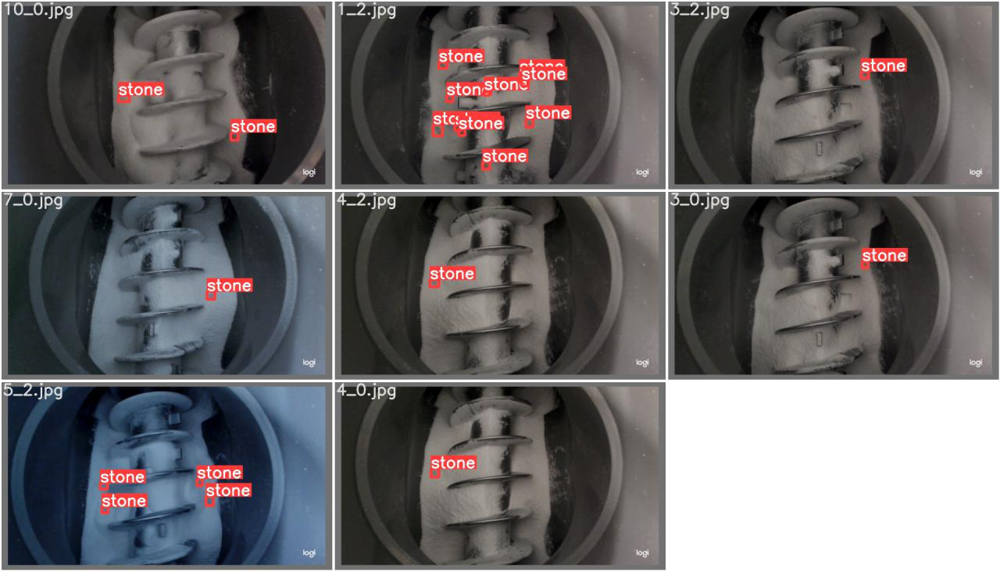

In [20]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5_stone/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


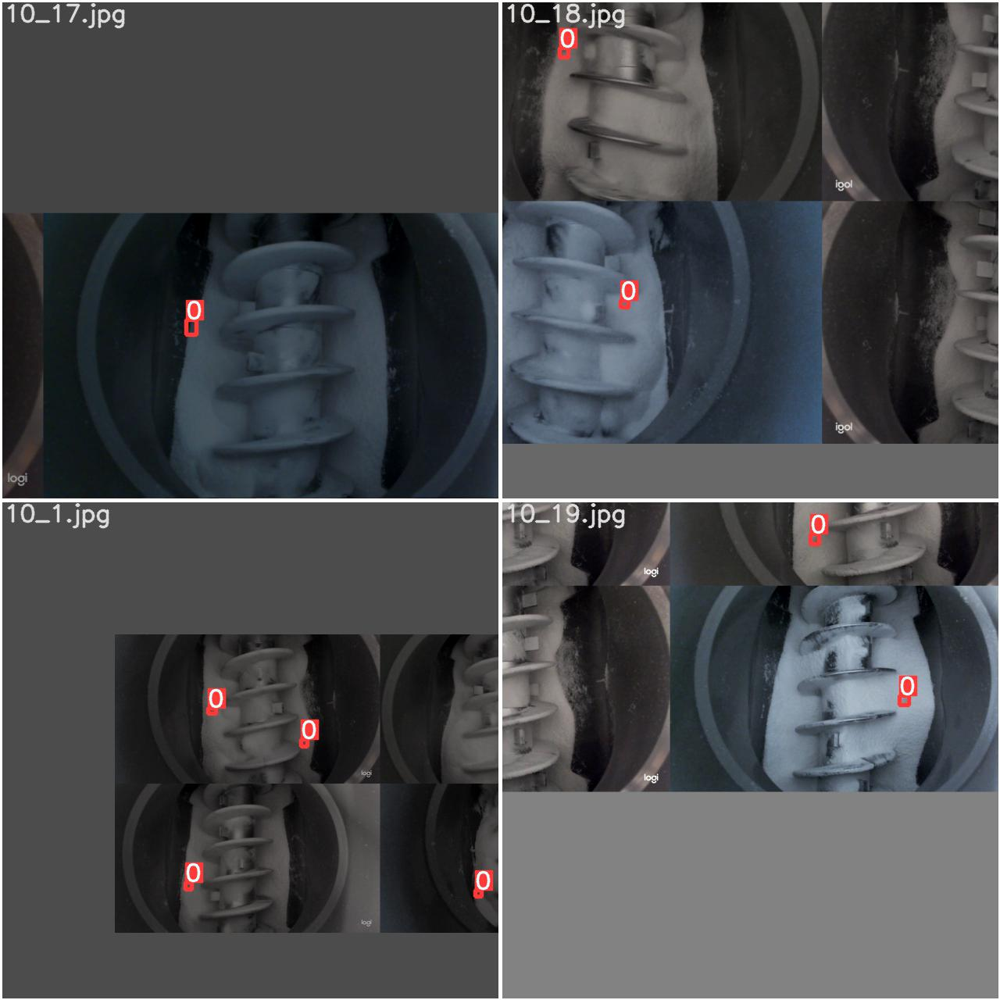

In [21]:
# print out an augmented training example
# Below is the augmented training data.
# NOTE: The dataset already contains the augmented data with annotations, so that you dont have to do it.
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5_stone/train_batch0.jpg', width=900)

# **Part 6:**
## Inference, detect our object.

In [22]:
# use the best weights!
# Final weights will be by-default stored at /content/yolov5/runs/train/exp2/weights/best.pt
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/train/yolov5_stone/weights/last.pt --img 640 --conf 0.6 --source ./valid/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.6, device='', exist_ok=False, half=False, hide_conf=False, hide_labels=False, img_size=640, iou_thres=0.45, line_thickness=3, max_det=1000, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='./valid/images', update=False, view_img=False, weights=['/content/yolov5/runs/train/yolov5_stone/weights/last.pt'])
YOLOv5 🚀 v5.0-160-gb6fdd2e torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients, 217.1 GFLOPs
image 1/22 /content/yolov5/valid/images/10_0.jpg: 384x640 2 stones, Done. (0.055s)
image 2/22 /content/yolov5/valid/images/10_2.jpg: 384x640 1 stone, Done. (0.054s)
image 3/22 /content/yolov5/valid/images/13_0.jpg: 384x640 2 stones, Done. (0.038s)
image 4/22 /content/yolov5/valid/images/13_2.jpg: 384x640 2 stones, Done. (0.037s)
image 5/22 /content/yolov5/valid/images/15_0.jpg: 

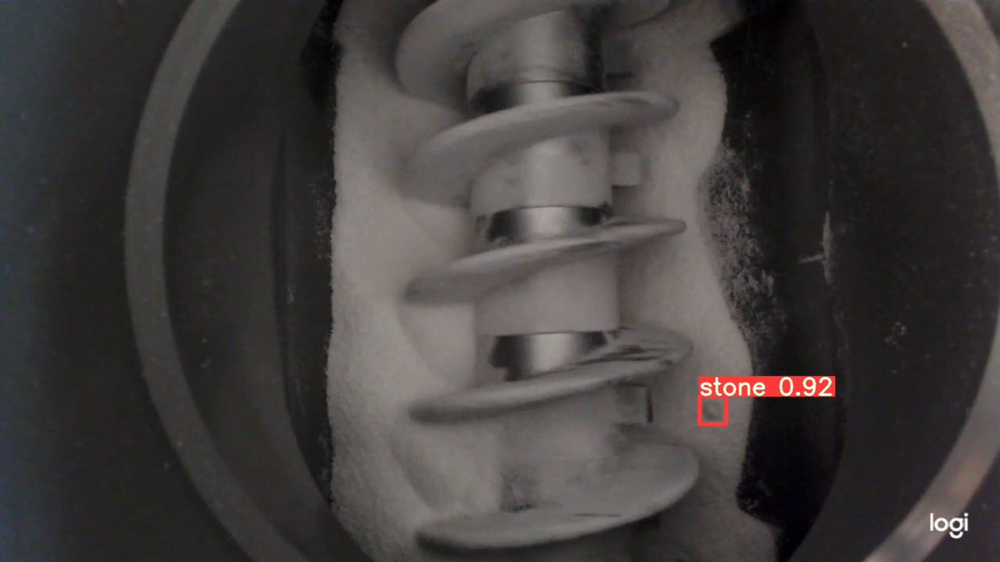

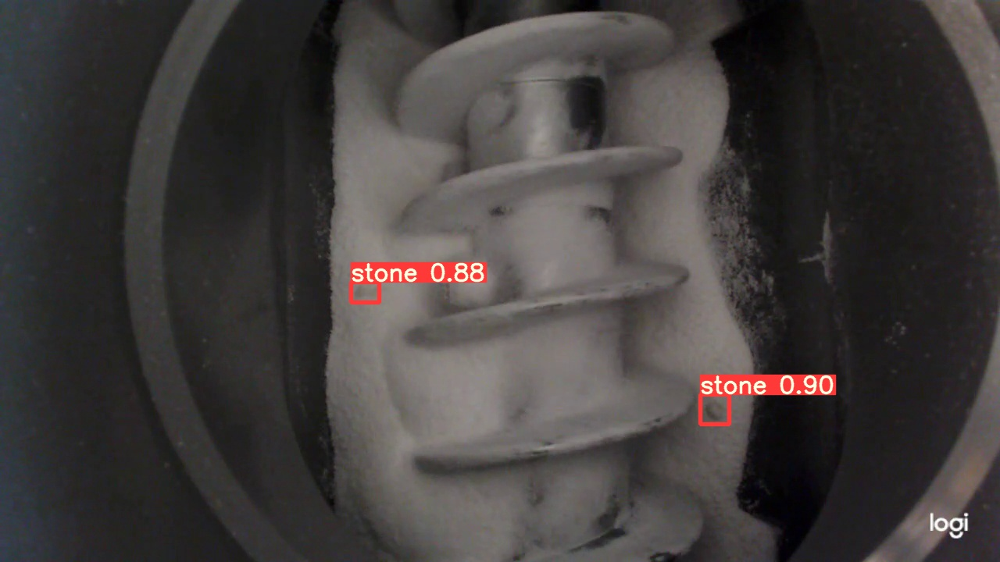

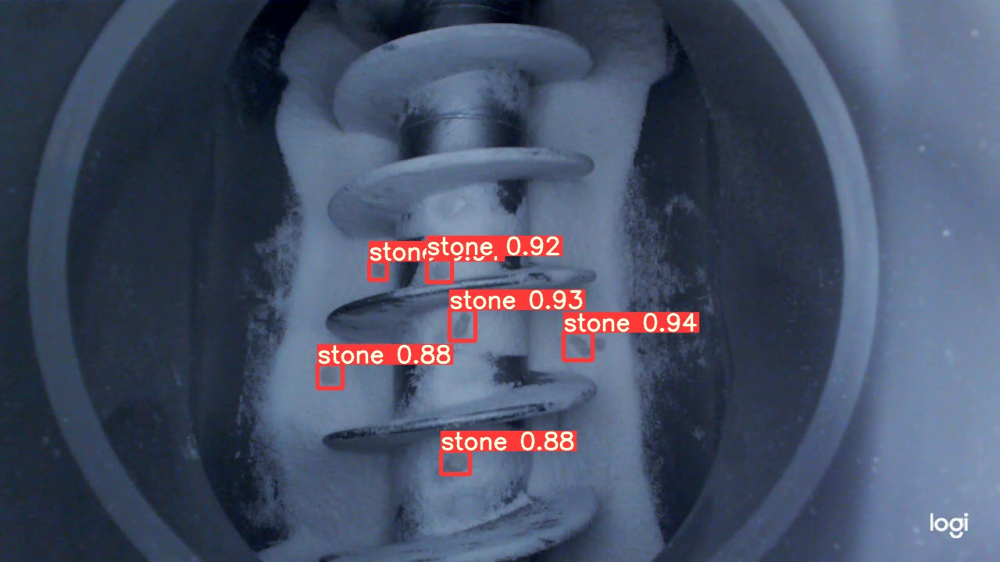

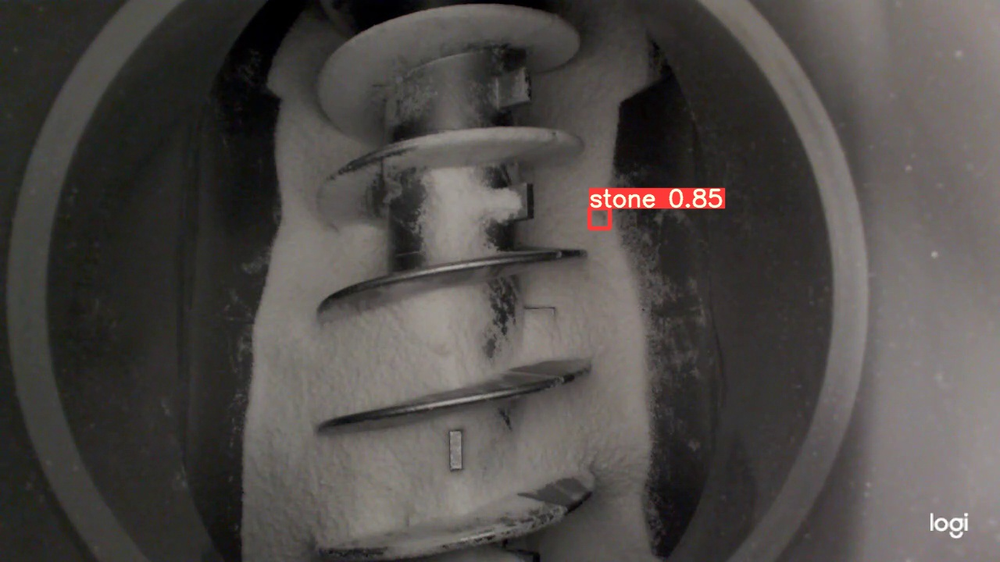

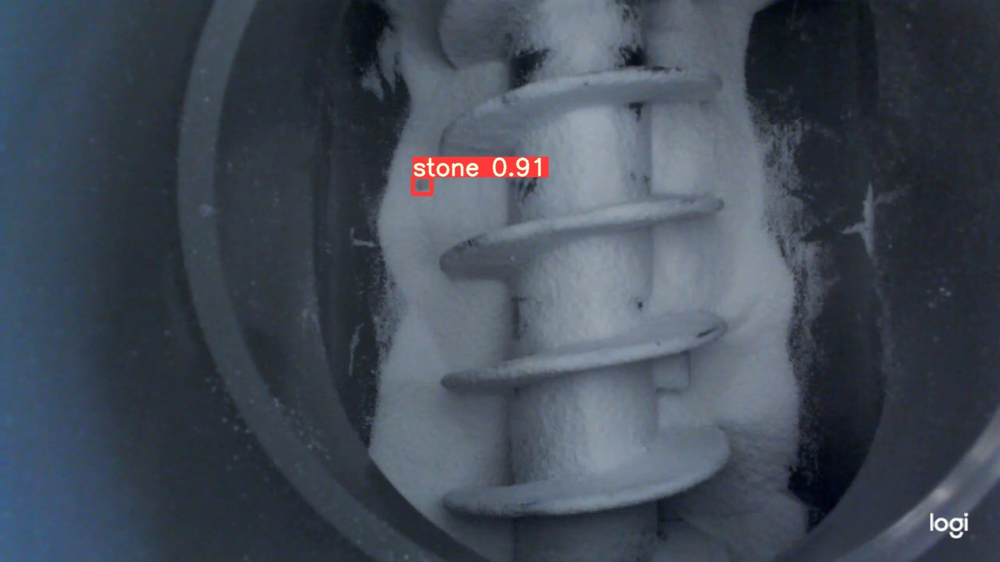

...

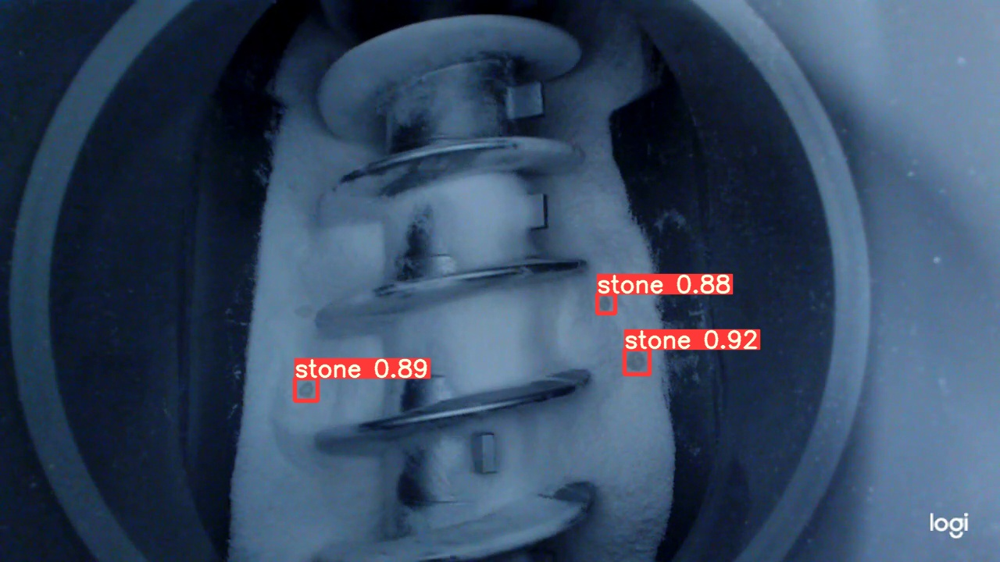

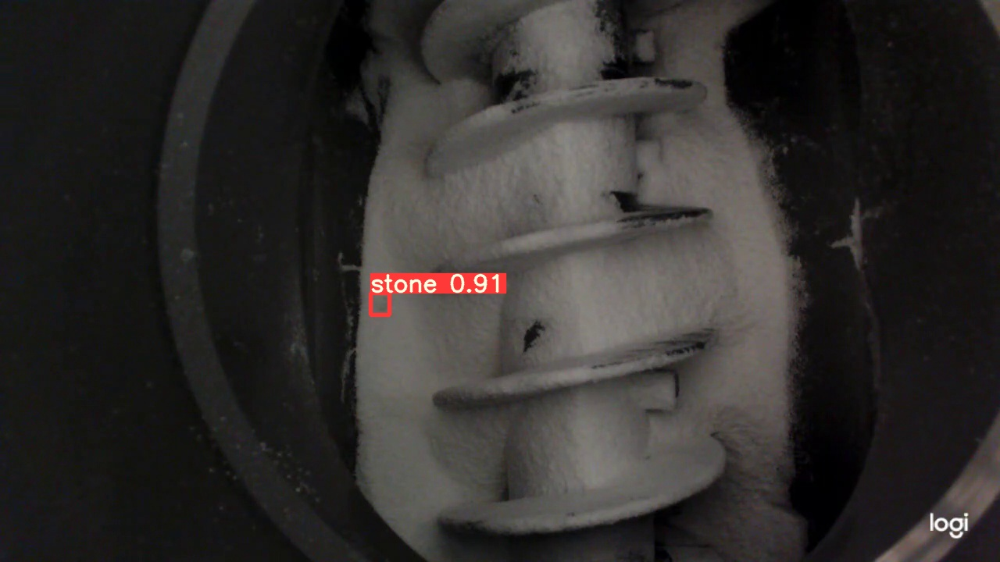

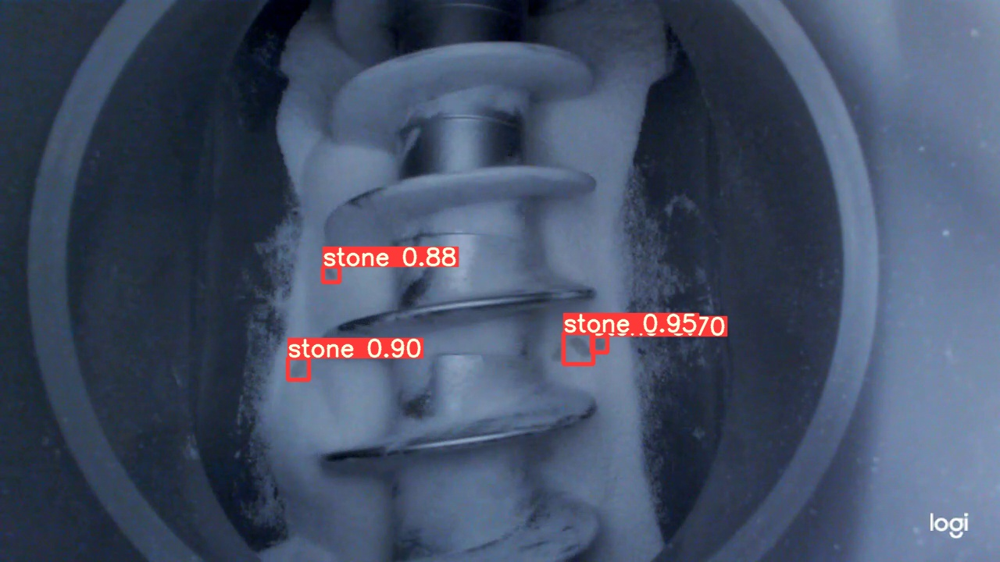

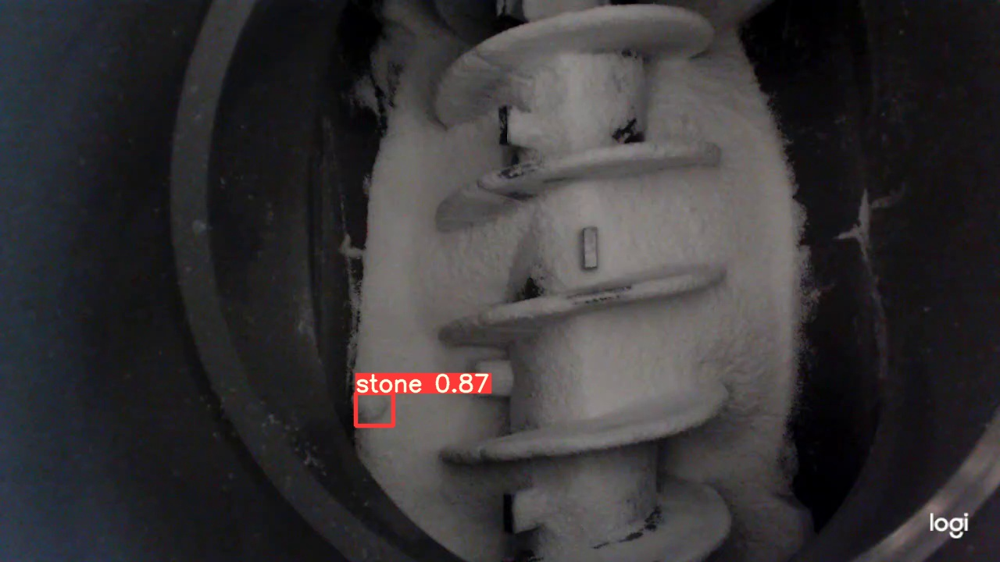

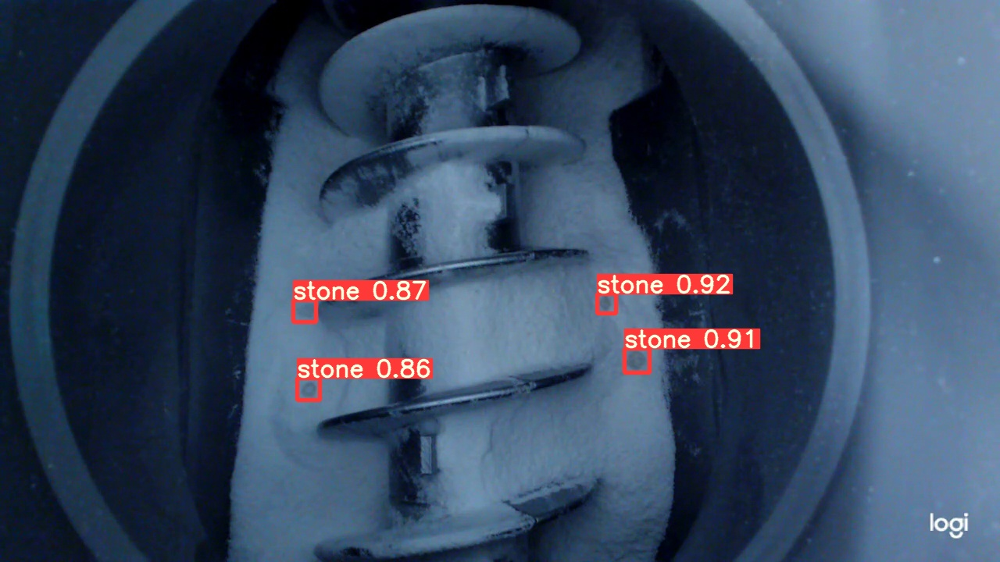

In [23]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG, check the above cell for your path.
    display(Image(filename=imageName))
    print("\n")

## **Video Inference**

---



In [24]:
!python detect.py --source /content/video.mp4 --weights /content/yolov5/runs/train/yolov5_stone/weights/last.pt --conf 0.6

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.6, device='', exist_ok=False, half=False, hide_conf=False, hide_labels=False, img_size=640, iou_thres=0.45, line_thickness=3, max_det=1000, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/content/video.mp4', update=False, view_img=False, weights=['/content/yolov5/runs/train/yolov5_stone/weights/last.pt'])
YOLOv5 🚀 v5.0-160-gb6fdd2e torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 476 layers, 87198694 parameters, 0 gradients, 217.1 GFLOPs
video 1/1 (1/334) /content/video.mp4: 384x640 2 stones, Done. (0.075s)
video 1/1 (2/334) /content/video.mp4: 384x640 2 stones, Done. (0.041s)
video 1/1 (3/334) /content/video.mp4: 384x640 2 stones, Done. (0.040s)
video 1/1 (4/334) /content/video.mp4: 384x640 2 stones, Done. (0.040s)
video 1/1 (5/334) /content/video.mp4: 384x640 2 stones, Done. (0.040s)
video 1/1 (6/334) /content/video.mp4: 

In [28]:
# Play the video
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/yolov5/runs/detect/exp2/video.mp4','rb').read() # check the above cell for the path to your video.
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# **Final:**
*Export and save your trained weights.*

In [ ]:
#Export Trained Weights for Future Inference
from google.colab import drive
drive.mount('/content/gdrive')

%cp /content/yolov5/runs/train/yolov5_stone/weights/last.pt /content/gdrive/My\ Drive